In [46]:
from pathlib import Path
import json
from collections import defaultdict
import shutil
import subprocess

In [47]:
from yolo_scripted import YoloFacade
from utils.general import non_max_suppression, check_img_size, scale_coords, coco80_to_coco91_class
from models.experimental import attempt_load
from utils.datasets import letterbox

In [48]:
import numpy as np
import mean_average_precision
import torch
import cv2

In [49]:
from typing import Iterable, List, Any, Callable, Iterable

## one-line scriptng

In [1]:
def script_weights(weights_path, device):
    print(subprocess.Popen(f'python models/export.py --weights {weights_path.as_posix()} --device cuda', 
                           shell=True, 
                           stdout=subprocess.PIPE).stdout.read())
    
    traced_path = weights_path.parents[0] / (weights_path.stem + '.torchscript.pt')
    scripted_path = weights_path.parents[0] / ('scripted_' + weights_path.stem + '.torchscript.pt')
    
    YoloFacade.script(
        yolo_path=weights_path,
        traced_path=traced_path,
        scripted_path=scripted_path,
        device=device
    )
    print(f'scripted model at {scripted_path}')

In [6]:
device = torch.device('cuda')
script_weights(Path('/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.pt'), device)

b"Namespace(batch_size=1, device='cuda', img_size=[640, 640], weights='/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.pt')\nFusing layers... \n\nStarting TorchScript export with torch 1.7.1...\nTorchScript export success, saved as /home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.torchscript.pt\nONNX export failure: No module named 'onnx'\nCoreML export failure: No module named 'coremltools'\n\nExport complete (5.24s). Visualize with https://github.com/lutzroeder/netron.\n"
Fusing layers... 
scripted model at /home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/scripted_best.torchscript.pt


In [13]:
model = YoloFacade.load(Path('/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/scripted_best.torchscript.pt'), device)

In [14]:
names = model.names

In [15]:
model = attempt_load('/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.pt', device)

Fusing layers... 


In [16]:
model.names

['none',
 'Главная дорога',
 'Уступи дорогу',
 'Стоп',
 'Кирпич',
 'Светофор',
 'Красный треугольник',
 'Красный круг',
 'Синий круг',
 'Синий квадрат',
 'Табличка',
 'Другие знаки',
 'автомобиль',
 'пешеход',
 'road']

In [17]:
model.names = names

In [18]:
model.names

['none',
 'road',
 'automobile',
 'human',
 'main road',
 'give way',
 'stop sign',
 'brick sign',
 'traffic light',
 'red triangle',
 'red circle',
 'blue circle',
 'blue square',
 'sign',
 'other signs']

In [21]:
torch.save(model.state_dict(), 'test.pt')

In [27]:
!python test.py --data /home/nikita/YOLOv3/evonets_yolo/evo_dataset/evo_dataset.yaml --weights /home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.pt --task test

Namespace(augment=False, batch_size=32, conf_thres=0.001, data='/home/nikita/YOLOv3/evonets_yolo/evo_dataset/evo_dataset.yaml', device='', exist_ok=False, img_size=640, iou_thres=0.6, name='exp', project='runs/test', save_conf=False, save_json=False, save_txt=False, single_cls=False, task='test', verbose=False, weights=['/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.pt'])
Using torch 1.7.1 CUDA:0 (GeForce RTX 2070 SUPER, 7979MB)

Fusing layers... 
Model Summary: 269 layers, 62621908 parameters, 0 gradients, 156.0 GFLOPS
Scanning '/home/nikita/YOLOv3/evonets_yolo/evo_dataset/labels/test.cache' for im
               Class      Images     Targets           P           R      mAP@.5/home/nikita/YOLOv3/evonets_yolo/utils/general.py:322: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /opt/conda/conda-bld/pytorch_1607370172916/work/torch/csrc/utils/pyt

## data preprocess

#### merge datasets

##### cones

In [6]:
cones_old_folder = Path('/home/nikita/evonets/data/pec_cones')

#### youtube

In [16]:
old_data_folder = Path('/home/nikita/evonets/data/youtube_alpha')

In [17]:
new_data_folder = Path('/home/nikita/YOLOv3/evonets_yolo/raw_evo_dataset/annotations')

In [18]:
all_images_folder = Path('/home/nikita/images')

In [19]:
with open((old_data_folder / 'params.json').as_posix()) as f:
    old_params = json.load(f)

In [20]:
old_classes = old_params['classes']

In [21]:
# find new class labels

# new_classes = defaultdict(set)
new_classes = old_classes

In [52]:
for filename in new_data_folder.glob('*'):
    with open(filename) as f:
        data = json.load(f)
        for item in data['categories']:
            new_classes[item['name']].add(item['id'])

In [54]:
new_classes = {key: list(value)[0] + 3 for key, value in new_classes.items()}

In [55]:
new_classes.update(old_params['classes'])

In [57]:
# write params new class labels

# with open((old_data_folder / 'params.json').as_posix(), 'w') as f:
#    old_params['classes'] = new_classes
#    json.dump(old_params, f)

In [22]:
new_classes_inverse = {value: key for key, value in new_classes.items()}

In [23]:
for key in sorted(new_classes_inverse.keys()):
    print(key, new_classes_inverse[key])

1 road
2 автомобиль
3 пешеход
4 Главная дорога
5 Уступи дорогу
6 Стоп
7 Кирпич
8 Светофор
9 Красный треугольник
10 Красный круг
11 Синий круг
12 Синий квадрат
13 Табличка
14 Другие знаки


get markdown from new data

In [12]:
import csv

In [16]:
markup = [['image','annotation', 'id', 'split']]

In [37]:
image_name_to_annotations = defaultdict(list)
image_name_to_info = {}

for filename in new_data_folder.glob('*'):
    image_id_to_image_name = {}
    
    with open(filename) as f:
        data = json.load(f)
        for item in data['images']:
            image_id_to_image_name[item['id']] = Path(item['file_name']).name
            image_name_to_info[Path(item['file_name']).name] = item
            
        
        for item in data['annotations']:
            detection = {'label': new_classes_inverse[item['category_id']], 'bbox': item['bbox']}
            image_name_to_annotations[image_id_to_image_name[item['image_id']]].append(detection)

In [40]:
image_name_to_annotations

defaultdict(list,
            {'4T3dDO4Rmrk_044880.jpg': [{'label': 'Красный круг',
               'bbox': [1788.65, 548.73, 21.6, 15.33]},
              {'label': 'Кирпич', 'bbox': [1787.95, 517.02, 27.88, 30.31]}],
             '4T3dDO4Rmrk_044820.jpg': [{'label': 'Синий круг',
               'bbox': [203.82, 539.83, 22.16, 48.51]}],
             '4T3dDO4Rmrk_044640.jpg': [{'label': 'Синий круг',
               'bbox': [281.67, 575.42, 25.79, 47.39]}],
             '4T3dDO4Rmrk_044580.jpg': [{'label': 'Синий круг',
               'bbox': [567.63, 620.19, 22.07, 30.2]},
              {'label': 'Синий круг',
               'bbox': [1763.89, 347.71, 156.11, 148.72]}],
             '4T3dDO4Rmrk_044520.jpg': [{'label': 'Красный треугольник',
               'bbox': [1852.31, 319.45, 36.58, 38.62]},
              {'label': 'Красный круг',
               'bbox': [1854.63, 359.52, 35.72, 20.91]}],
             '4T3dDO4Rmrk_044280.jpg': [{'label': 'Синий круг',
               'bbox': [1442.72,

In [43]:
image_name_to_info

{'4T3dDO4Rmrk_045240.jpg': {'id': 1,
  'width': 1920,
  'height': 1080,
  'file_name': 'splitted/4T3dDO4Rmrk_00/4T3dDO4Rmrk_045240.jpg',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 '4T3dDO4Rmrk_045180.jpg': {'id': 2,
  'width': 1920,
  'height': 1080,
  'file_name': 'splitted/4T3dDO4Rmrk_00/4T3dDO4Rmrk_045180.jpg',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 '4T3dDO4Rmrk_045120.jpg': {'id': 3,
  'width': 1920,
  'height': 1080,
  'file_name': 'splitted/4T3dDO4Rmrk_00/4T3dDO4Rmrk_045120.jpg',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 '4T3dDO4Rmrk_045060.jpg': {'id': 4,
  'width': 1920,
  'height': 1080,
  'file_name': 'splitted/4T3dDO4Rmrk_00/4T3dDO4Rmrk_045060.jpg',
  'license': 0,
  'flickr_url': '',
  'coco_url': '',
  'date_captured': 0},
 '4T3dDO4Rmrk_045000.jpg': {'id': 5,
  'width': 1920,
  'height': 1080,
  'file_name': 'splitted/4T3dDO4Rmrk_00/4T3dDO4Rmrk_045000.jpg',
  'lice

add new data to existing dataset

In [24]:
annotations_folder = old_data_folder / 'annotations'
images_folder = old_data_folder / 'images'

In [46]:
for image_filename, detections in image_name_to_annotations.items():
    an_file = annotations_folder / (Path(image_filename).stem + '.json')
    
    if an_file.exists():
        with open(an_file) as f:
            data = json.load(f)

        data['objects'] = data['objects'] + detections
        
    else:
        shutil.copy(all_images_folder / image_filename, images_folder / image_filename)
        
        data = {}
        data['width'] = image_name_to_info[image_filename]['width']
        data['height'] = image_name_to_info[image_filename]['height']
        data['filename'] = image_filename
        data['objects'] = detections
    
    with open(an_file, 'w') as f:
        json.dump(data, f)

#### make training dataset

In [54]:
annotations_folder = Path('/home/nikita/evonets/data/pec_cones') / 'annotations'
images_folder = Path('/home/nikita/evonets/data/pec_cones') / 'images'

In [55]:
dataset_path = Path('/home/nikita/YOLOv3/evonets_yolo/cones_dataset')

In [56]:
def objects_to_strings(objects, width, height):
    result = []
    for obj in objects:
        if 'bbox' not in obj:
            continue
        
        mapping = {"конус": 15,
                   "автомобиль": 2,
                   "пешеход": 3}
        
        label = mapping[obj['label']]
        
        # konus
        if int(label) == 1:
            label = 15
        
        x = (obj['bbox'][0] + obj['bbox'][2] / 2) / width
        y = (obj['bbox'][1] + obj['bbox'][3] / 2) / height
        w = obj['bbox'][2] / width
        h = obj['bbox'][3] / height
        
        result.append(f'{label} {x} {y} {w} {h}\n')
        
    return result

In [57]:
def objects_to_gt(objects):
    result = []
    
    for obj in objects:
        if 'bbox' not in obj:
            continue
            
        label = new_classes[obj['label']]
        bbox = obj['bbox']
        result.append(bbox + [label])
        
    return result

In [58]:
im_train_dir = dataset_path / 'images' / 'train'
im_val_dir = dataset_path / 'images' / 'val'
im_test_dir = dataset_path / 'images' / 'test'
an_train_dir = dataset_path / 'labels' / 'train'
an_val_dir = dataset_path / 'labels' / 'val'
an_test_dir = dataset_path / 'labels' / 'test'

In [59]:
test_size = 50
val_size = 30

In [60]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
%matplotlib 
from PIL import Image

Using matplotlib backend: agg


In [64]:
annotations_folder = Path('/home/nikita/evonets/data/bags_historical/annotations')
images_folder = Path('/home/nikita/evonets/data/bags_historical/images')

<ipython-input-66-796ed23a139f>:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=(16,12))


TypeError: Image data of dtype object cannot be converted to float

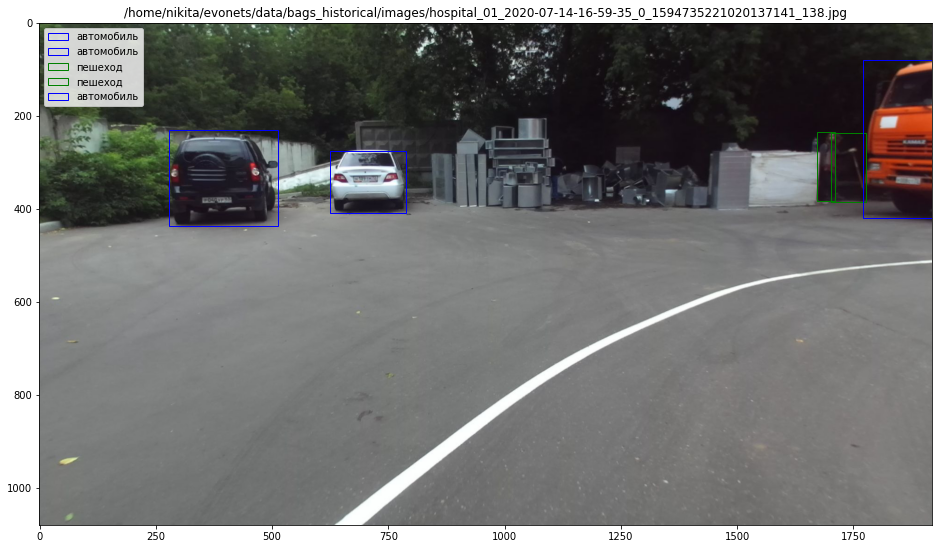

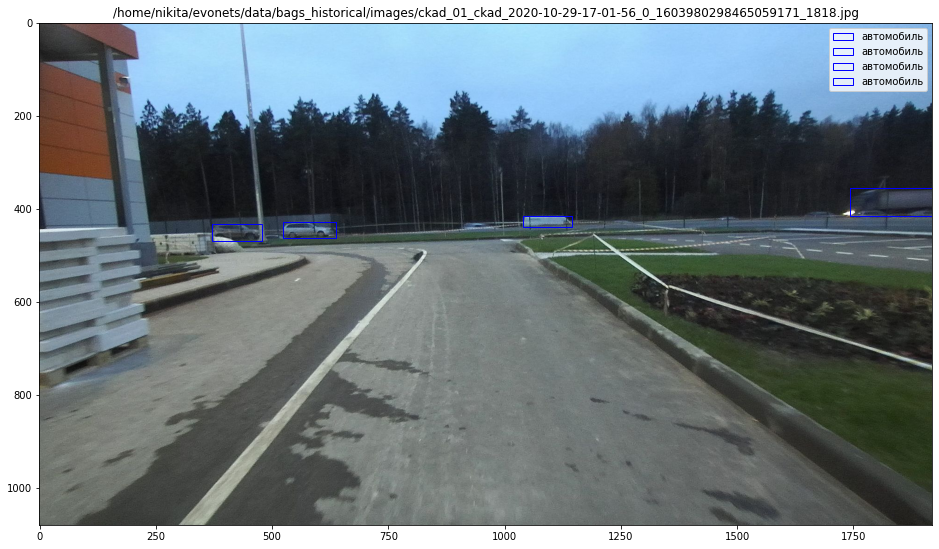

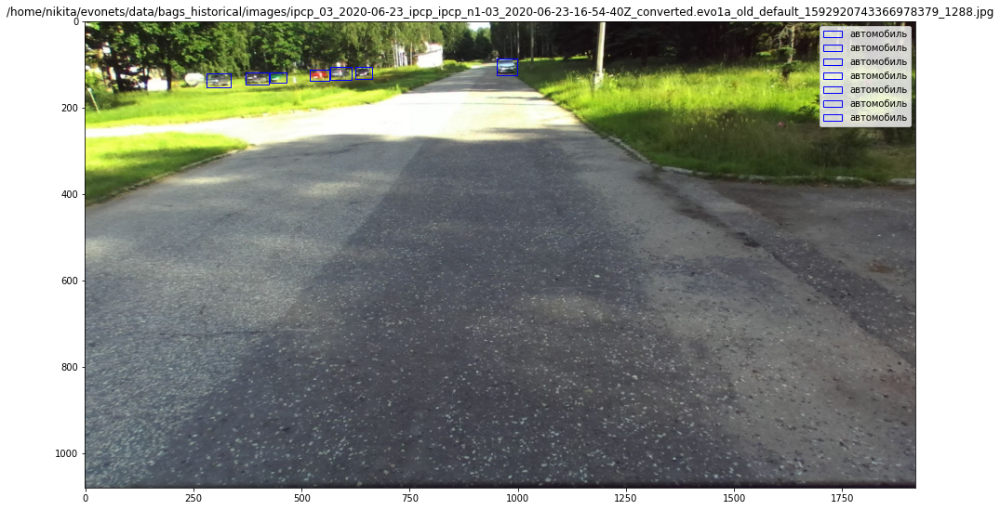

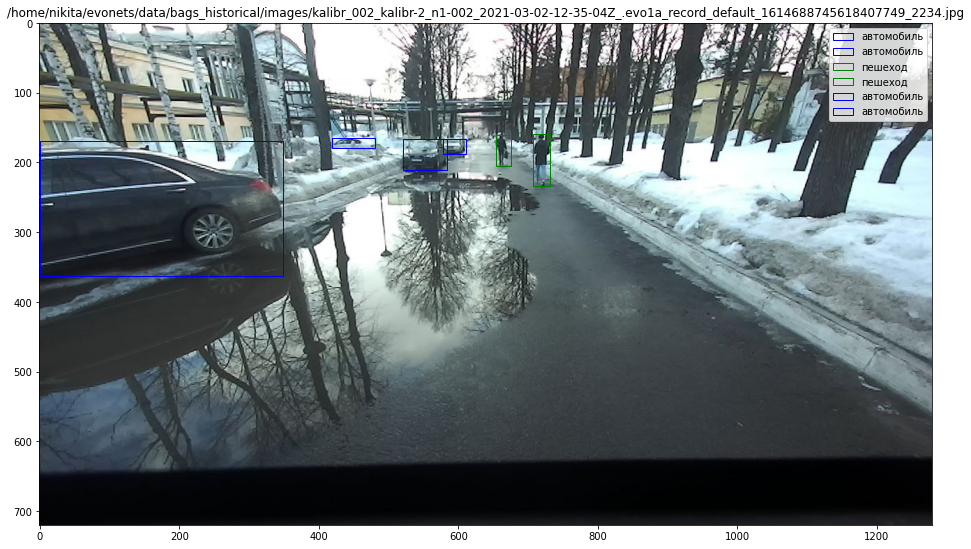

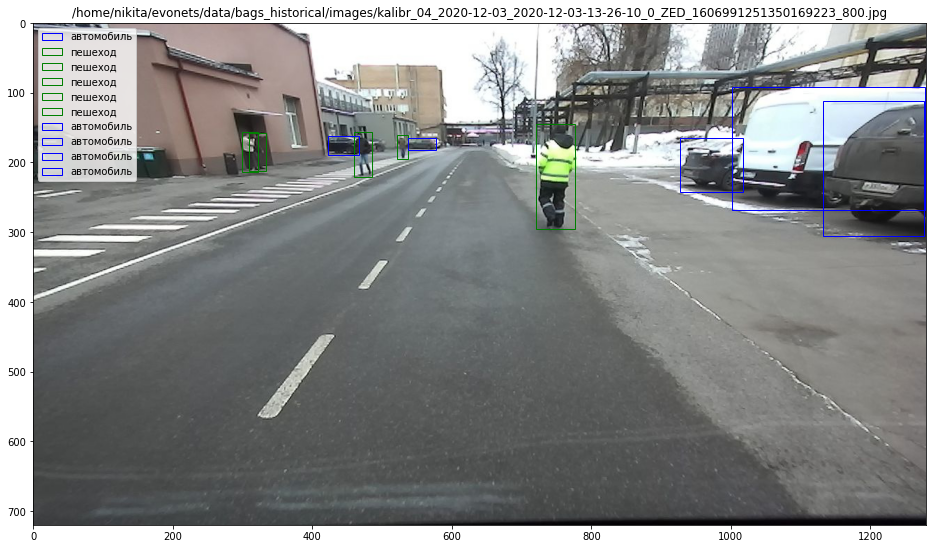

...

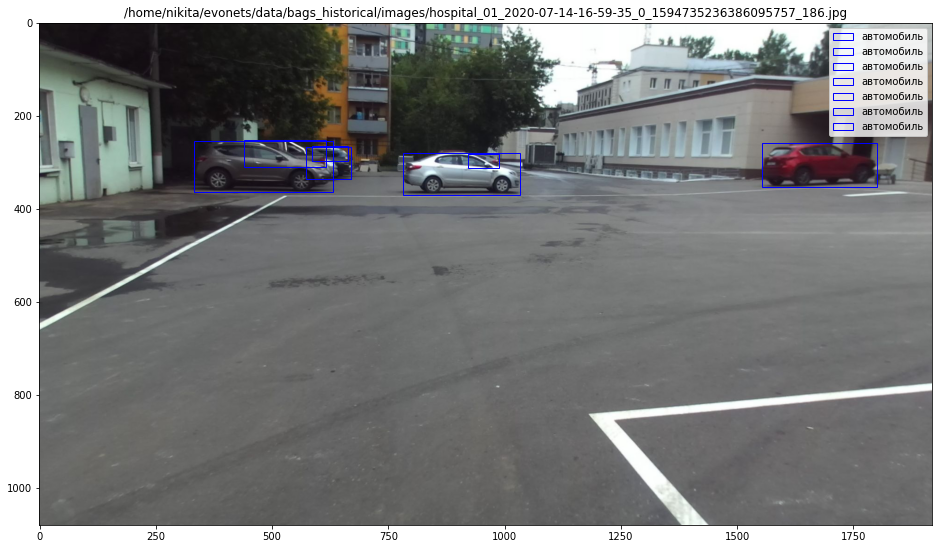

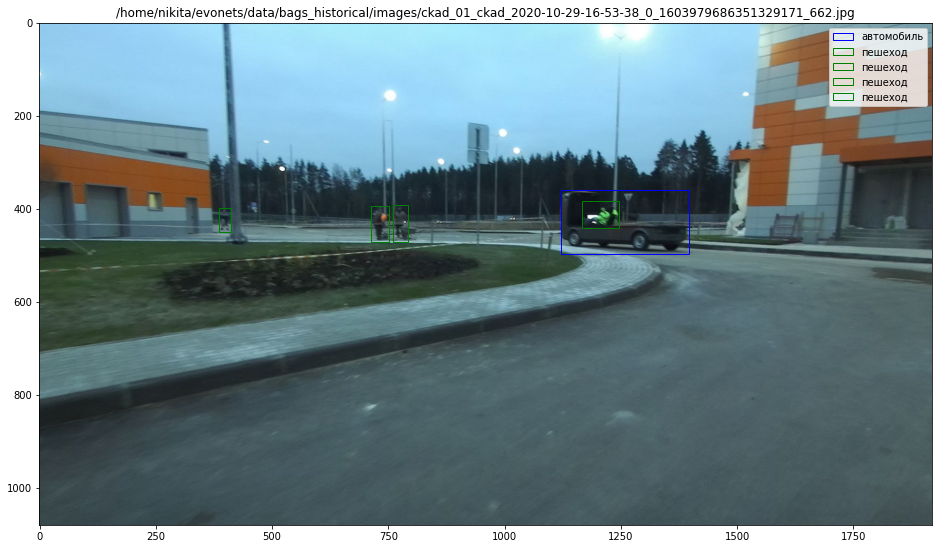

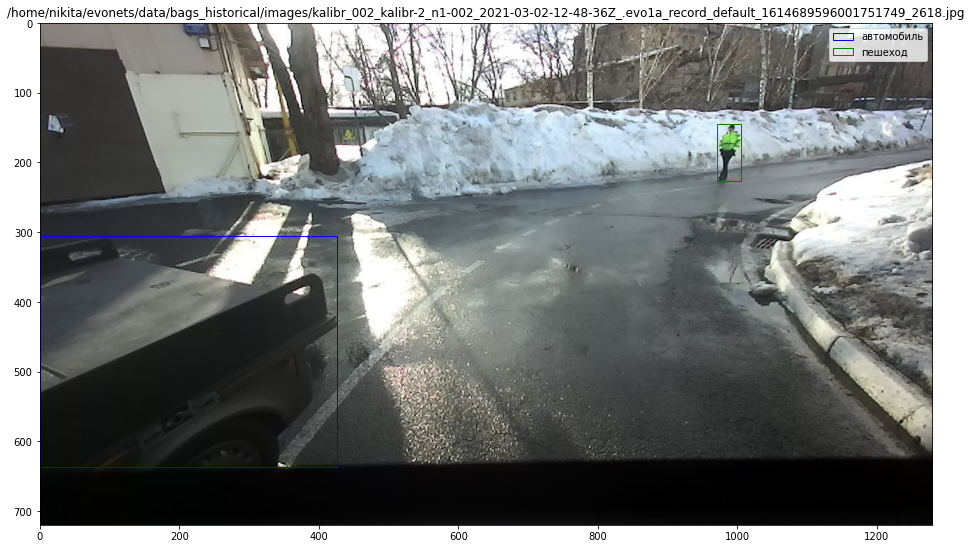

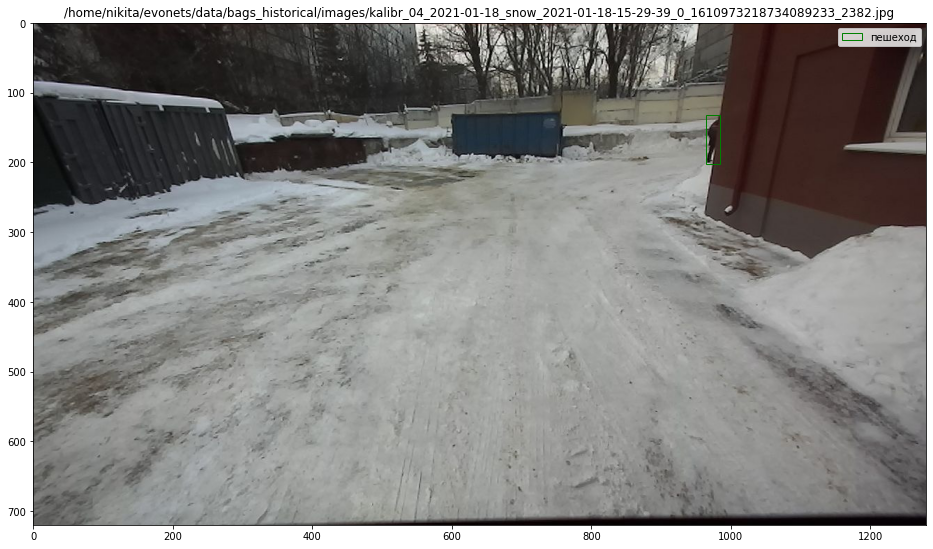

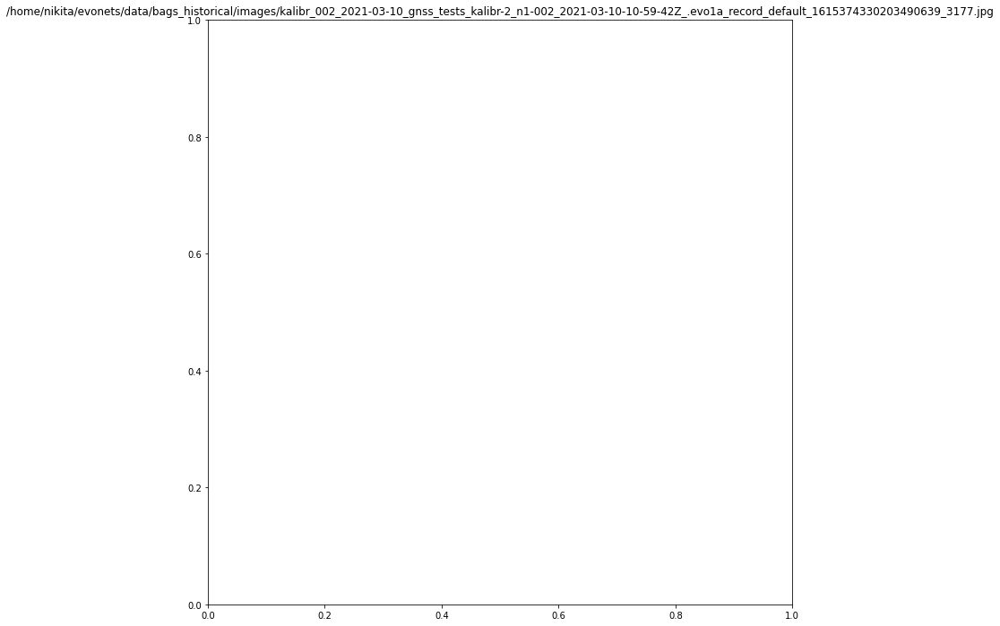

In [66]:
labels = set()

i = 0
for index, filename in enumerate(annotations_folder.glob('*.json')):    
    with open(filename) as f:
        data = json.load(f)
        
        stem = Path(data['filename']).stem
        
        image_path = images_folder / data['filename']
        width = data['width']
        height = data['height']
        objects = data['objects']
        
        new_annotations = objects_to_strings(objects, width, height)
        for an in new_annotations:
            labels.add(an.split()[0])
        
        if index < test_size:
            im_dir = im_test_dir
            an_dir = an_test_dir
        elif test_size + val_size > index >= test_size:
            im_dir = im_val_dir
            an_dir = an_val_dir
        else:
            im_dir = im_train_dir
            an_dir = an_train_dir
           
        with Image.open(image_path) as im:
            fig, ax = plt.subplots(figsize=(16,12))
            
            for obj in objects:
                col = {'конус': 'r', 'пешеход': 'g', 'автомобиль': 'b'}
                bb = obj['bbox']
                rect = patches.Rectangle((bb[0], bb[1]), bb[2], bb[3], linewidth=1, edgecolor=col[obj['label']], facecolor='none', label=obj['label'])
                ax.add_patch(rect)
                
            ax.title.set_text(image_path)
            ax.imshow(im)
            ax.legend()
            
            plt.savefig(f'/home/nikita/YOLOv3/evonets_yolo/cones_dataset/plots/HISTORICAL{stem}.jpg')
           
        if i > 5:
            break
        #i += 1
            
        # with open(an_dir / (stem + '.txt'), 'w') as f:
        #     f.writelines(new_annotations)
                
        # shutil.copy(image_path, im_dir / (stem + '.jpg'))

In [62]:
labels

{'15', '2', '3'}

In [19]:
images = dataset_path / 'images'

In [34]:
index = 0
markup = [['image','annotation', 'id', 'split']]

In [35]:
for filename in (images / 'train').glob('*'):
    stem = filename.stem
    print([f'images/{stem}.jpg', f'annotations/{stem}.json', str(index), 'train'])
    markup.append([f'images/{stem}.jpg', f'annotations/{stem}.json', str(index), 'train'])
    index += 1

['images/IHcsvh6Ioow_018660.jpg', 'annotations/IHcsvh6Ioow_018660.json', '0', 'train']
['images/4T3dDO4Rmrk_026460.jpg', 'annotations/4T3dDO4Rmrk_026460.json', '1', 'train']
['images/_D98BAqhey4_100980.jpg', 'annotations/_D98BAqhey4_100980.json', '2', 'train']
['images/tRB4qdyBpes_152880.jpg', 'annotations/tRB4qdyBpes_152880.json', '3', 'train']
['images/4T3dDO4Rmrk_058500.jpg', 'annotations/4T3dDO4Rmrk_058500.json', '4', 'train']
['images/_D98BAqhey4_087180.jpg', 'annotations/_D98BAqhey4_087180.json', '5', 'train']
['images/_D98BAqhey4_046080.jpg', 'annotations/_D98BAqhey4_046080.json', '6', 'train']
['images/_D98BAqhey4_065640.jpg', 'annotations/_D98BAqhey4_065640.json', '7', 'train']
['images/IHcsvh6Ioow_028800.jpg', 'annotations/IHcsvh6Ioow_028800.json', '8', 'train']
['images/_D98BAqhey4_054360.jpg', 'annotations/_D98BAqhey4_054360.json', '9', 'train']
['images/0DfyHMHhyZU_091320.jpg', 'annotations/0DfyHMHhyZU_091320.json', '10', 'train']
['images/tRB4qdyBpes_110640.jpg', 'annotat

['images/_D98BAqhey4_047880.jpg', 'annotations/_D98BAqhey4_047880.json', '4516', 'train']
['images/V56MouI2KH0_064800.jpg', 'annotations/V56MouI2KH0_064800.json', '4517', 'train']
['images/IHcsvh6Ioow_026580.jpg', 'annotations/IHcsvh6Ioow_026580.json', '4518', 'train']
['images/tRB4qdyBpes_099660.jpg', 'annotations/tRB4qdyBpes_099660.json', '4519', 'train']
['images/IHcsvh6Ioow_040680.jpg', 'annotations/IHcsvh6Ioow_040680.json', '4520', 'train']
['images/_D98BAqhey4_036660.jpg', 'annotations/_D98BAqhey4_036660.json', '4521', 'train']
['images/s6Ps6hzrOTc_078126.jpg', 'annotations/s6Ps6hzrOTc_078126.json', '4522', 'train']
['images/V56MouI2KH0_103680.jpg', 'annotations/V56MouI2KH0_103680.json', '4523', 'train']
['images/tRB4qdyBpes_006540.jpg', 'annotations/tRB4qdyBpes_006540.json', '4524', 'train']
['images/0DfyHMHhyZU_053100.jpg', 'annotations/0DfyHMHhyZU_053100.json', '4525', 'train']
['images/_D98BAqhey4_107100.jpg', 'annotations/_D98BAqhey4_107100.json', '4526', 'train']
['images/0

['images/4T3dDO4Rmrk_103380.jpg', 'annotations/4T3dDO4Rmrk_103380.json', '9515', 'train']
['images/s6Ps6hzrOTc_077778.jpg', 'annotations/s6Ps6hzrOTc_077778.json', '9516', 'train']
['images/tRB4qdyBpes_067080.jpg', 'annotations/tRB4qdyBpes_067080.json', '9517', 'train']
['images/IHcsvh6Ioow_003060.jpg', 'annotations/IHcsvh6Ioow_003060.json', '9518', 'train']
['images/tRB4qdyBpes_206280.jpg', 'annotations/tRB4qdyBpes_206280.json', '9519', 'train']
['images/ZnpukT5oJek_001632.jpg', 'annotations/ZnpukT5oJek_001632.json', '9520', 'train']
['images/tRB4qdyBpes_057480.jpg', 'annotations/tRB4qdyBpes_057480.json', '9521', 'train']
['images/0DfyHMHhyZU_088020.jpg', 'annotations/0DfyHMHhyZU_088020.json', '9522', 'train']
['images/V56MouI2KH0_085800.jpg', 'annotations/V56MouI2KH0_085800.json', '9523', 'train']
['images/F-Q7Zq_kPCo_043020.jpg', 'annotations/F-Q7Zq_kPCo_043020.json', '9524', 'train']
['images/Z7U-tGVPHOE_120240.jpg', 'annotations/Z7U-tGVPHOE_120240.json', '9525', 'train']
['images/0

In [36]:
for filename in (images / 'val').glob('*'):
    stem = filename.stem
    print([f'images/{stem}.jpg', f'annotations/{stem}.json', str(index), 'val'])
    markup.append([f'images/{stem}.jpg', f'annotations/{stem}.json', str(index), 'val'])
    index += 1

['images/U_U1pK2xBcg_001248.jpg', 'annotations/U_U1pK2xBcg_001248.json', '13908', 'val']
['images/4T3dDO4Rmrk_115740.jpg', 'annotations/4T3dDO4Rmrk_115740.json', '13909', 'val']
['images/Xj_tCWFbyaA_028608.jpg', 'annotations/Xj_tCWFbyaA_028608.json', '13910', 'val']
['images/U_U1pK2xBcg_004992.jpg', 'annotations/U_U1pK2xBcg_004992.json', '13911', 'val']
['images/tRB4qdyBpes_054240.jpg', 'annotations/tRB4qdyBpes_054240.json', '13912', 'val']
['images/0DfyHMHhyZU_040560.jpg', 'annotations/0DfyHMHhyZU_040560.json', '13913', 'val']
['images/Xj_tCWFbyaA_024528.jpg', 'annotations/Xj_tCWFbyaA_024528.json', '13914', 'val']
['images/V56MouI2KH0_054960.jpg', 'annotations/V56MouI2KH0_054960.json', '13915', 'val']
['images/4T3dDO4Rmrk_023040.jpg', 'annotations/4T3dDO4Rmrk_023040.json', '13916', 'val']
['images/_D98BAqhey4_017940.jpg', 'annotations/_D98BAqhey4_017940.json', '13917', 'val']
['images/s6Ps6hzrOTc_030044.jpg', 'annotations/s6Ps6hzrOTc_030044.json', '13918', 'val']
['images/_D98BAqhey4_

In [37]:
for filename in (images / 'test').glob('*'):
    stem = filename.stem
    print([f'images/{stem}.jpg', f'annotations/{stem}.json', str(index), 'test'])
    markup.append([f'images/{stem}.jpg', f'annotations/{stem}.json', str(index), 'test'])
    index += 1

['images/8jbez-oxKnE_026600.jpg', 'annotations/8jbez-oxKnE_026600.json', '14408', 'test']
['images/0DfyHMHhyZU_052380.jpg', 'annotations/0DfyHMHhyZU_052380.json', '14409', 'test']
['images/4T3dDO4Rmrk_061140.jpg', 'annotations/4T3dDO4Rmrk_061140.json', '14410', 'test']
['images/Xj_tCWFbyaA_016896.jpg', 'annotations/Xj_tCWFbyaA_016896.json', '14411', 'test']
['images/V56MouI2KH0_103740.jpg', 'annotations/V56MouI2KH0_103740.json', '14412', 'test']
['images/0DfyHMHhyZU_064200.jpg', 'annotations/0DfyHMHhyZU_064200.json', '14413', 'test']
['images/0DfyHMHhyZU_050640.jpg', 'annotations/0DfyHMHhyZU_050640.json', '14414', 'test']
['images/tRB4qdyBpes_047520.jpg', 'annotations/tRB4qdyBpes_047520.json', '14415', 'test']
['images/Z7U-tGVPHOE_100680.jpg', 'annotations/Z7U-tGVPHOE_100680.json', '14416', 'test']
['images/IHcsvh6Ioow_022080.jpg', 'annotations/IHcsvh6Ioow_022080.json', '14417', 'test']
['images/0DfyHMHhyZU_056880.jpg', 'annotations/0DfyHMHhyZU_056880.json', '14418', 'test']
['images/t

In [44]:
for i in range(len(markup)):
    markup[i] = markup[i] + '\n'

In [45]:
markup

['image,annotation,id,split\n',
 'images/IHcsvh6Ioow_018660.jpg,annotations/IHcsvh6Ioow_018660.json,0,train\n',
 'images/4T3dDO4Rmrk_026460.jpg,annotations/4T3dDO4Rmrk_026460.json,1,train\n',
 'images/_D98BAqhey4_100980.jpg,annotations/_D98BAqhey4_100980.json,2,train\n',
 'images/tRB4qdyBpes_152880.jpg,annotations/tRB4qdyBpes_152880.json,3,train\n',
 'images/4T3dDO4Rmrk_058500.jpg,annotations/4T3dDO4Rmrk_058500.json,4,train\n',
 'images/_D98BAqhey4_087180.jpg,annotations/_D98BAqhey4_087180.json,5,train\n',
 'images/_D98BAqhey4_046080.jpg,annotations/_D98BAqhey4_046080.json,6,train\n',
 'images/_D98BAqhey4_065640.jpg,annotations/_D98BAqhey4_065640.json,7,train\n',
 'images/IHcsvh6Ioow_028800.jpg,annotations/IHcsvh6Ioow_028800.json,8,train\n',
 'images/_D98BAqhey4_054360.jpg,annotations/_D98BAqhey4_054360.json,9,train\n',
 'images/0DfyHMHhyZU_091320.jpg,annotations/0DfyHMHhyZU_091320.json,10,train\n',
 'images/tRB4qdyBpes_110640.jpg,annotations/tRB4qdyBpes_110640.json,11,train\n',
 'imag

In [46]:
with open('markup.csv', 'w') as f:
    f.writelines(markup)

#### now i manually write evo_dataset.yaml

### Clear empty data

In [31]:
for an_file in an_train_dir.glob('*'):
    with open(an_file) as f:
        name = Path(an_file)
        if len(f.readline()) == 0:
            name.unlink()
            (im_train_dir / (name.stem + '.jpg')).unlink()

In [33]:
for an_file in an_val_dir.glob('*'):
    with open(an_file) as f:
        name = Path(an_file)
        if len(f.readline()) == 0:
            name.unlink()
            (im_val_dir / (name.stem + '.jpg')).unlink()

In [34]:
for an_file in an_test_dir.glob('*'):
    with open(an_file) as f:
        name = Path(an_file)
        if len(f.readline()) == 0:
            name.unlink()
            (im_test_dir / (name.stem + '.jpg')).unlink()

### train

In [7]:
torch.cuda.is_available()

True

In [1]:
!python train.py --img 640 --batch 4 --epochs 16 --data evo_dataset/evo_dataset.yaml --weights yolov3-spp.pt

Using torch 1.8.0 CUDA:0 (GeForce RTX 2070 SUPER, 7979MB)

Namespace(adam=False, batch_size=4, bucket='', cache_images=False, cfg='', data='evo_dataset/evo_dataset.yaml', device='', epochs=16, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[640, 640], local_rank=-1, log_imgs=16, multi_scale=False, name='exp', noautoanchor=False, nosave=False, notest=False, project='runs/train', rect=False, resume=False, save_dir='runs/train/exp46', single_cls=False, sync_bn=False, total_batch_size=4, weights='yolov3-spp.pt', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'warmup_bias_lr': 0.1, 'box': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0.0, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, '

## test

In [35]:
# abstract

def get_mAP(predicted, groundtruth, n_classes, classes_mapping=None):
    """Evaluates detection metric.
    
    Args:
        predicted: [images X detections on image X [x_left y_top x_right y_bottom confidence label]]
        groundtruth: [images X detections on image X [x_left y_top width height label]]
        n_classes: number of classes
        classes_mappng: from predicted to groundtruth. For example, groundtruth has label '3' for person,
            predicted has label '2' for person. Then pass classes_mapping={2: 3}
            
    Returns:
        dict: {'COCO_mAP': mAP@0.5:0.95:0.05,
               'PASCAL_mAP': mAP@0.5,
               'class_AP': {class label: AP@0.5}}
    """    
    metric_builder = mean_average_precision.MeanAveragePrecision2d(n_classes)
    
    for one_image_pred, one_image_gt in zip(predicted, groundtruth):
        one_image_gt = np.array(one_image_gt)
        one_image_pred = np.array(one_image_pred)
        
        if one_image_gt.size == 0:
            continue
        
        # [xmin, ymin, xmax, ymax, label, confidence]
        one_image_pred = one_image_pred[:, [0, 1, 2, 3, 5, 4]]
        for detection in one_image_pred:            
            # map labels
            
            if classes_mapping is not None and detection[5] in classes_mapping:
                detection[5] = classes_mapping[detection[5]]
                
        # [xmin, ymin, xmax, ymax, class_id, difficult, crowd]
        for detection in one_image_gt:
            #xywh -> xyxy
            detection[2] += detection[0]
            detection[3] += detection[1]
            
            
        # difficult, crowd
        gt = np.zeros((one_image_gt.shape[0], 7), dtype=int)
        gt[:one_image_gt.shape[0],:one_image_gt.shape[1]] = one_image_gt
          
        metric_builder.add(one_image_pred, gt)
        
    coco_metrics = metric_builder.value(iou_thresholds=np.arange(0.5, 1.0, 0.05), 
                                    recall_thresholds=np.arange(0., 1.01, 0.01), 
                                    mpolicy='soft')
    
    ap = {key: value['ap'] for key, value in coco_metrics[0.5].items()}
    
    coco_map = coco_metrics['mAP']
    
    pascal_map = metric_builder.value(iou_thresholds=0.5, 
                                      recall_thresholds=np.arange(0., 1.1, 0.1))['mAP']
    
    
    
    return {'COCO_mAP': coco_map, 'PASCAL_mAP': pascal_map, 'class_AP': ap}
    

In [36]:
def detect_single(source: Path, model, device: torch.device, imgsz: int = 640):
        image = source.absolute().as_posix()

        max_stride = model.stride.max()
        imgsz = check_img_size(imgsz, s=max_stride)  # check img_size

        # Run inference
        im0 = cv2.imread(image, 1)
        img = letterbox(im0, new_shape=imgsz)[0]
        img = img[:, :, ::-1].transpose(2, 0, 1)  # BGR to RGB, to 3x416x416
        img = np.ascontiguousarray(img)

        img = torch.from_numpy(img).to(device)
        img = img.float()  # uint8 to fp16/32
        img /= 255.0  # 0 - 255 to 0.0 - 1.0
        if img.ndimension() == 3:
            img = img.unsqueeze(0)

        # Inference
        with torch.no_grad():
            pred = model(img)

        # Process detections
        det = pred[0]
        if len(det) > 0:
            det[:, :4] = scale_coords(img.shape[2:], det[:, :4], im0.shape)

        return det


#### base

In [32]:
base_path = Path('/home/nikita/YOLOv3/evonets_yolo/whole-yolov3-spp.torchscript.pt')

In [105]:
model = YoloFacade.load(base_path, device)

In [106]:
groundtruth = []
predicted = []

for filename in an_test_dir.glob('*'): 
    filename = annotations_folder / (filename.stem + '.json')
    with open(filename) as f:
        data = json.load(f)

        objects = data['objects']
        
        groundtruth.append(objects_to_gt(objects))
        
    image = im_test_dir / (filename.stem + '.jpg')
    predicted.append(detect_single(image, model, device).cpu().numpy())

In [107]:
mapping = {i: 0 for i in range(100)}
mapping[0] = 13  # person
mapping[2] = 12  # automobile
mapping[5] = 12  # bus
mapping[7] = 12  # truck

In [108]:
get_mAP(predicted, groundtruth, 15, mapping)

{'COCO_mAP': 0.022142084,
 'PASCAL_mAP': 0.03732616,
 'class_AP': {0: 0.0,
  1: 0.0,
  2: 0.49696103,
  3: 0.00046410892,
  4: 0.0,
  5: 0.0,
  6: 0.0,
  7: 3.0371136e-06,
  8: 0.0,
  9: 0.028071586,
  10: 0.003150315,
  11: 0.00054853864,
  12: 0.0,
  13: 0.0,
  14: 0.0}}

#### new

In [26]:
script_weights(Path('/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.pt'), device)

b"Namespace(batch_size=1, device='cuda', img_size=[640, 640], weights='/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.pt')\nFusing layers... \n\nStarting TorchScript export with torch 1.7.1...\nTorchScript export success, saved as /home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/best.torchscript.pt\nONNX export failure: No module named 'onnx'\nCoreML export failure: No module named 'coremltools'\n\nExport complete (3.60s). Visualize with https://github.com/lutzroeder/netron.\n"
Fusing layers... 


UnsupportedNodeError: try blocks aren't supported:
  File "/home/nikita/.conda/envs/yolo/lib/python3.8/pathlib.py", line 1387
        Whether this path exists.
        """
        try:
        ~~~ <--- HERE
            self.stat()
        except OSError as e:
'__torch__.pathlib.Path' is being compiled since it was called from 'YoloFacade.forward'
  File "/home/nikita/YOLOv3/evonets_yolo/yolo_scripted.py", line 23
    def __init__(
    ~~~~~~~~~~~~~
        self,
        ~~~~~
        traced_path: File,
        ~~~~~~~~~~~~~~~~~~
        stride: Tensor,
        ~~~~~~~~~~~~~~~
        anchor_grid: Tensor,
        ~~~~~~~~~~~~~~~~~~~~
        conf_thres: float = 0.25,
        ~~~~~~~~~~~~~~~~~~~~~~~~~
        iou_thres: float = 0.45,
        ~~~~~~~~~~~~~~~~~~~~~~~~
        agnostic_nms: bool = True,
        ~~~~~~~~~~~~~~~~~~~~~~~~~~
        device: Device = default_device,
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    ):
    ~~
        '''
        ~~~
        Args:
        ~~~~~
            traced_path: path to traced model
            ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
            stride, anchor_grid: params from full fledged model to convert bboxes
            ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
                to original scale
                ~~~~~~~~~~~~~~~~~
            conf_thres, iou_thres, agnostic_nms: params of NMS
            ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
            device: cuda or cpu
            ~~~~~~~~~~~~~~~~~~~
        '''
        ~~~
        super().__init__()
        ~~~~~~~~~~~~~~~~~~

        self.stride = stride
        ~~~~~~~~~~~~~~~~~~~~
        self.anchor_grid = anchor_grid
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.device = device
        ~~~~~~~~~~~~~~~~~~~~
        self.conf_thres = conf_thres
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.iou_thres = iou_thres
        ~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.agnostic_nms = agnostic_nms
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        
        self.names = []
        ~~~~~~~~~~~~~~~

        self.model = torch.jit.load(traced_path.as_posix(), map_location=self.device)
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.model.eval()
        ~~~~~~~~~~~~~~~~~

        self._grid = [torch.tensor(()), torch.tensor(()), torch.tensor(())]
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ <--- HERE
'YoloFacade.forward' is being compiled since it was called from 'YoloFacade.forward'
  File "/home/nikita/YOLOv3/evonets_yolo/yolo_scripted.py", line 23
    def __init__(
    ~~~~~~~~~~~~~
        self,
        ~~~~~
        traced_path: File,
        ~~~~~~~~~~~~~~~~~~
        stride: Tensor,
        ~~~~~~~~~~~~~~~
        anchor_grid: Tensor,
        ~~~~~~~~~~~~~~~~~~~~
        conf_thres: float = 0.25,
        ~~~~~~~~~~~~~~~~~~~~~~~~~
        iou_thres: float = 0.45,
        ~~~~~~~~~~~~~~~~~~~~~~~~
        agnostic_nms: bool = True,
        ~~~~~~~~~~~~~~~~~~~~~~~~~~
        device: Device = default_device,
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
    ):
    ~~
        '''
        ~~~
        Args:
        ~~~~~
            traced_path: path to traced model
            ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
            stride, anchor_grid: params from full fledged model to convert bboxes
            ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
                to original scale
                ~~~~~~~~~~~~~~~~~
            conf_thres, iou_thres, agnostic_nms: params of NMS
            ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
            device: cuda or cpu
            ~~~~~~~~~~~~~~~~~~~
        '''
        ~~~
        super().__init__()
        ~~~~~~~~~~~~~~~~~~

        self.stride = stride
        ~~~~~~~~~~~~~~~~~~~~
        self.anchor_grid = anchor_grid
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.device = device
        ~~~~~~~~~~~~~~~~~~~~
        self.conf_thres = conf_thres
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.iou_thres = iou_thres
        ~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.agnostic_nms = agnostic_nms
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        
        self.names = []
        ~~~~~~~~~~~~~~~

        self.model = torch.jit.load(traced_path.as_posix(), map_location=self.device)
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
        self.model.eval()
        ~~~~~~~~~~~~~~~~~

        self._grid = [torch.tensor(()), torch.tensor(()), torch.tensor(())]
        ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ <--- HERE


In [22]:
new_path = Path('/home/nikita/YOLOv3/evonets_yolo/runs/train/exp37/weights/scripted_best.torchscript.pt')

In [23]:
model = YoloFacade.load(new_path, device)

In [24]:
model.names

ModuleAttributeError: 'RecursiveScriptModule' object has no attribute 'names'

In [40]:
groundtruth = []
predicted = []

for filename in an_test_dir.glob('*'): 
    filename = annotations_folder / (filename.stem + '.json')
    with open(filename) as f:
        data = json.load(f)

        objects = data['objects']
        
        groundtruth.append(objects_to_gt(objects))
        
    image = im_test_dir / (filename.stem + '.jpg')
    predicted.append(detect_single(image, model, device).cpu().numpy())

In [41]:
get_mAP(predicted, groundtruth, 15)

{'COCO_mAP': 0.27169412,
 'PASCAL_mAP': 0.44593588,
 'class_AP': {0: 0.0,
  1: 0.6580129,
  2: 0.83256346,
  3: 0.6368752,
  4: 0.34844735,
  5: 0.55146134,
  6: 0.6600901,
  7: 0.73344696,
  8: 0.5967911,
  9: 0.6928739,
  10: 0.53744805,
  11: 0.6149324,
  12: 0.0,
  13: 0.0,
  14: 0.0}}

In [1]:
model.conf

NameError: name 'model' is not defined